In [24]:
import os

slides = [l.rstrip() for l in open('./lists/slides.list', 'r')]
slides

['Z:/Scanscope images\\2021-11-05 Cresyl Violet aCING EK\\2011-269-33F_L_aCING_Cresyl Violet_XX_11-05-21_EK.svs',
 'Z:/Scanscope images\\2022-08-11 MEGURO M1 IronGlia\\2003-099-22F_L_M1_MeguroTriton_08-11-22_WT.svs',
 'Z:/Scanscope images\\2023-04-04 TDP43 FTLD lib\\2012-171-42F_L_pCING_TDP43_6K_04-04-23_PS.svs',
 'Z:/Scanscope images\\2023-05-01 AT8 PART\\2017-042-34F_N_HIP_AT8_1K_04-27-23_SA.svs',
 'Z:/Scanscope images\\2023-05-11 GFAP FTLD new\\2019-097-64F_L_aITC_GFAP_4K_05-11-23_PS.svs',
 'Z:/Scanscope images\\2023-05-23 SMI-32\\2021-170-31F_R_aCING_SMI32_2K_05-23-23_ML.svs']

2023-07-18 15:46:06,331 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 168 :: Loading Frame from .svs slide file...
2023-07-18 15:46:09,855 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 170 :: Done Loading Frame!
[[0.05629216 0.05629216 0.0120885 ]
 [0.11428411 0.10987499 0.12098287]
 [0.         0.         0.        ]]
0 72
2023-07-18 15:46:22,723 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 168 :: Loading Frame from .svs slide file...
2023-07-18 15:46:24,024 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 170 :: Done Loading Frame!
[[0.14886161 0.15856691 0.11428411]
 [0.03732432 0.0641175  0.09478632]
 [0.         0.         0.        ]]
0 224
2023-07-18 15:46:29,933 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 168 :: Loading Frame from .svs slide file...
2023-07-18 15:46:30,694 :: INFO :: sana_loader.py :: <func> load_roi_frame :: Line: 170 :: Done Loading Frame!
[[0.13238233 0.14646879 0.07008045]
 [0.08639389 0.

C:\Users\noahcapp\AppData\Local\Temp/ipykernel_6048/4064071754.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(2,2, figsize=(20,20))


0 231


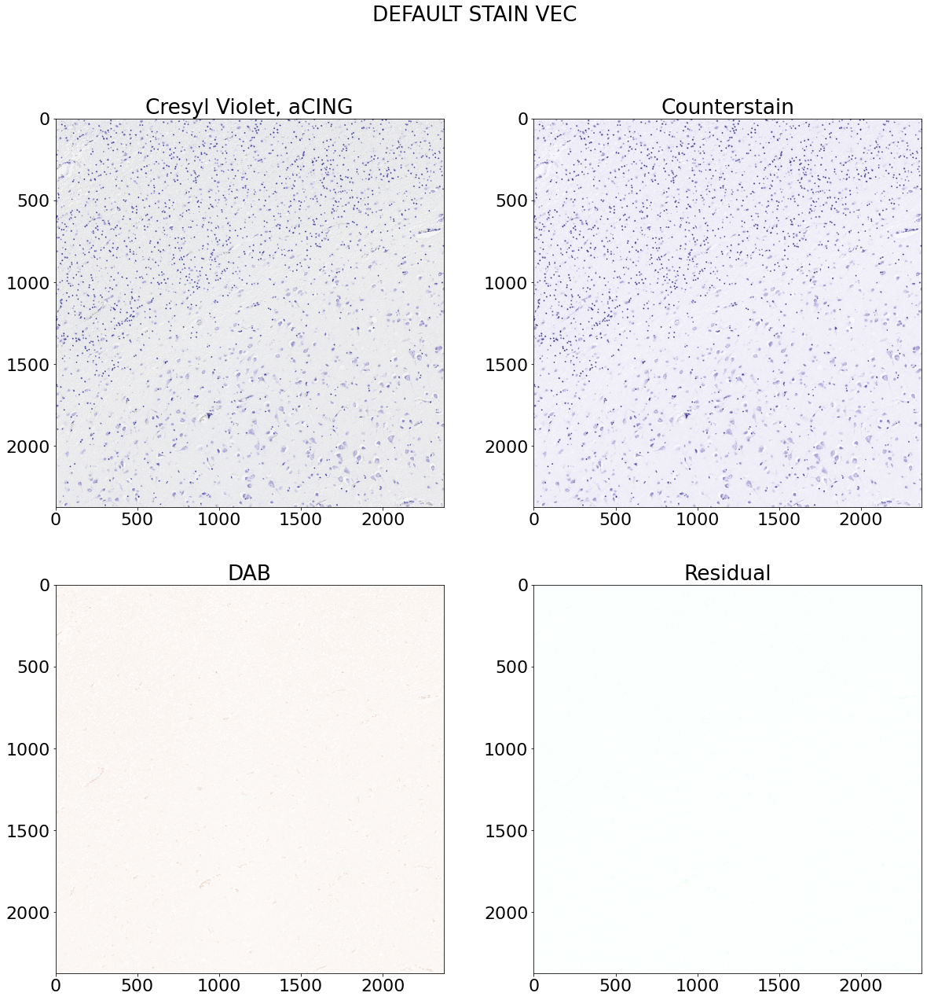

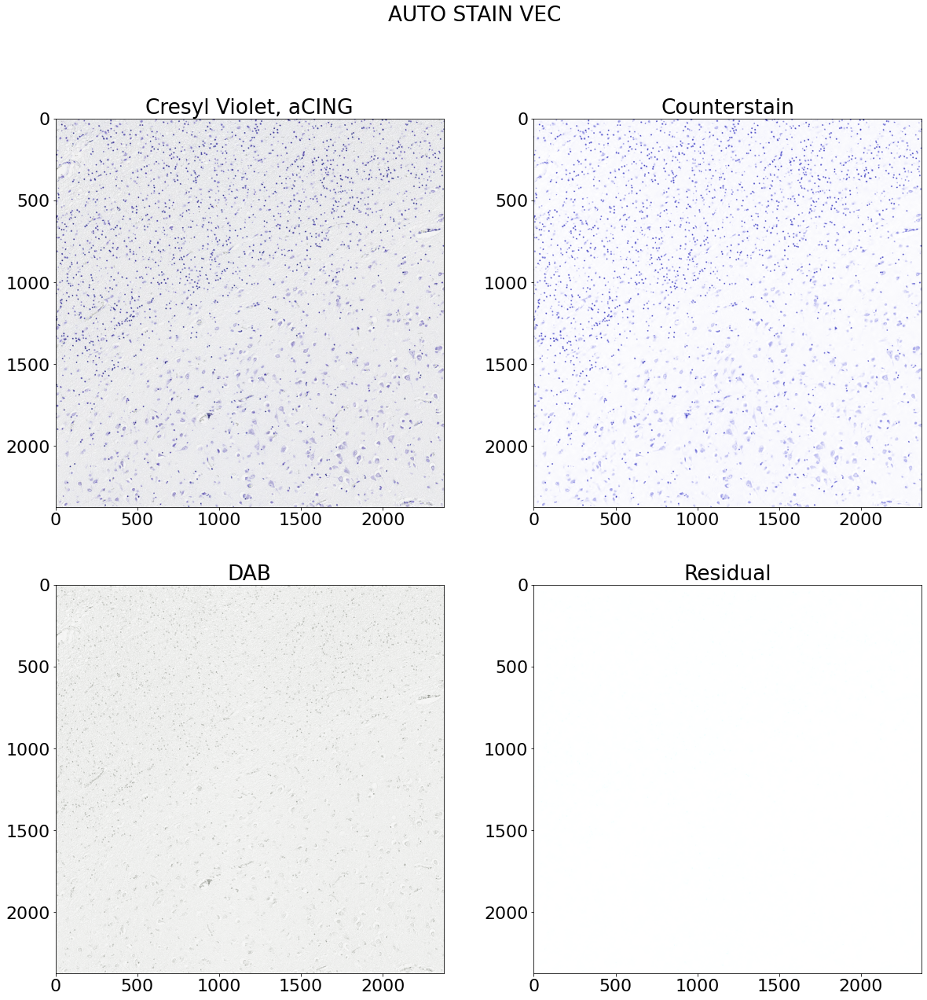

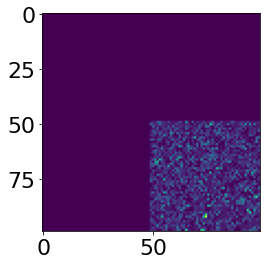

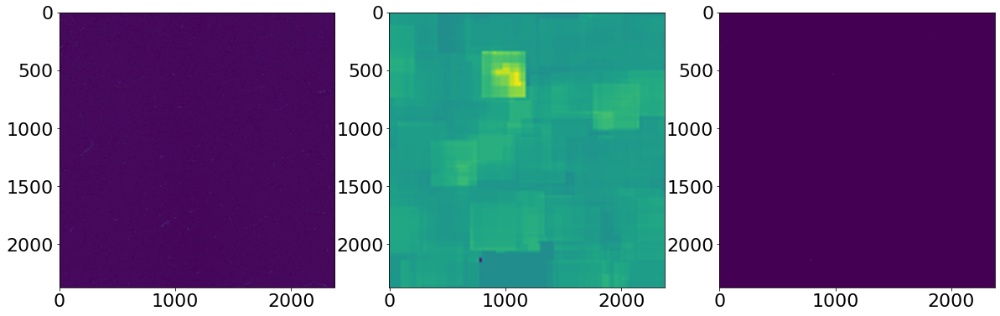

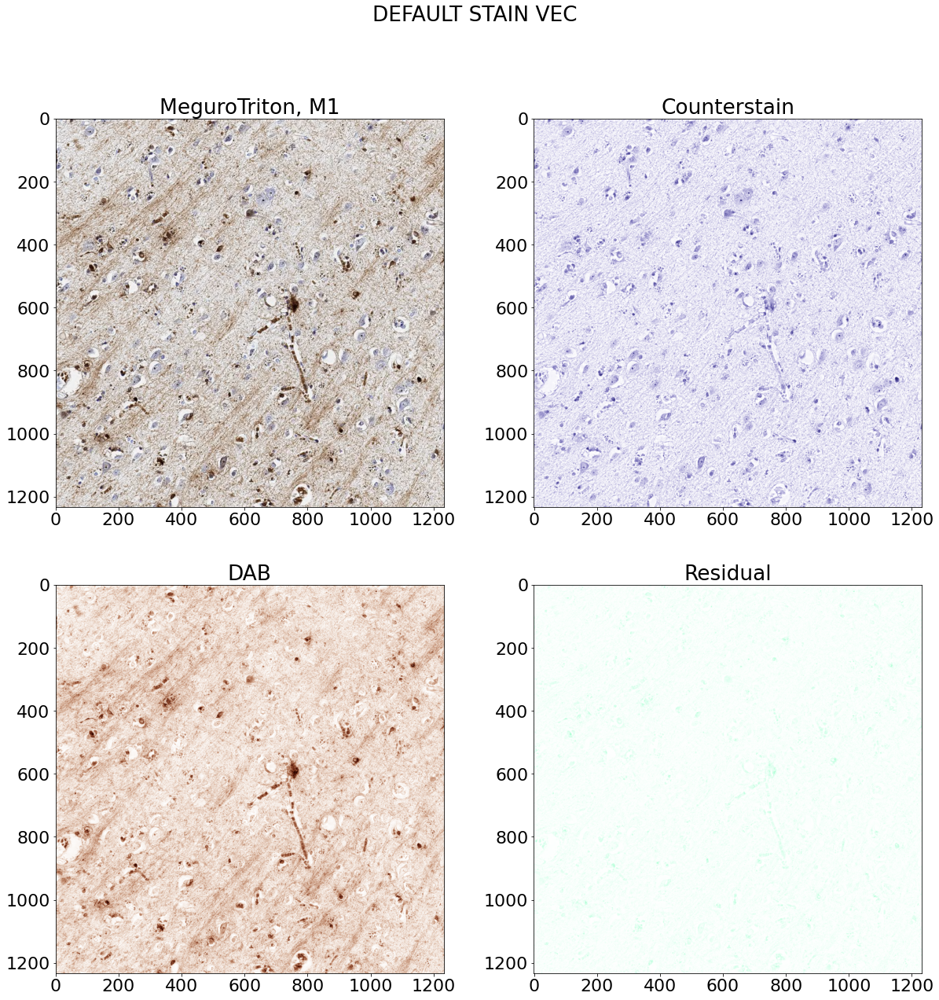

...

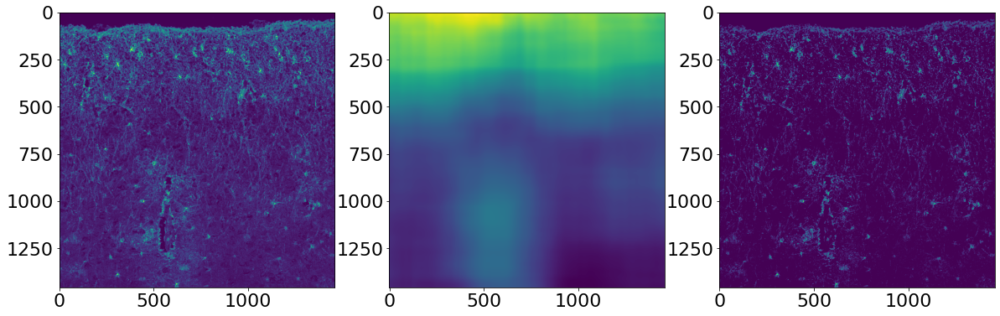

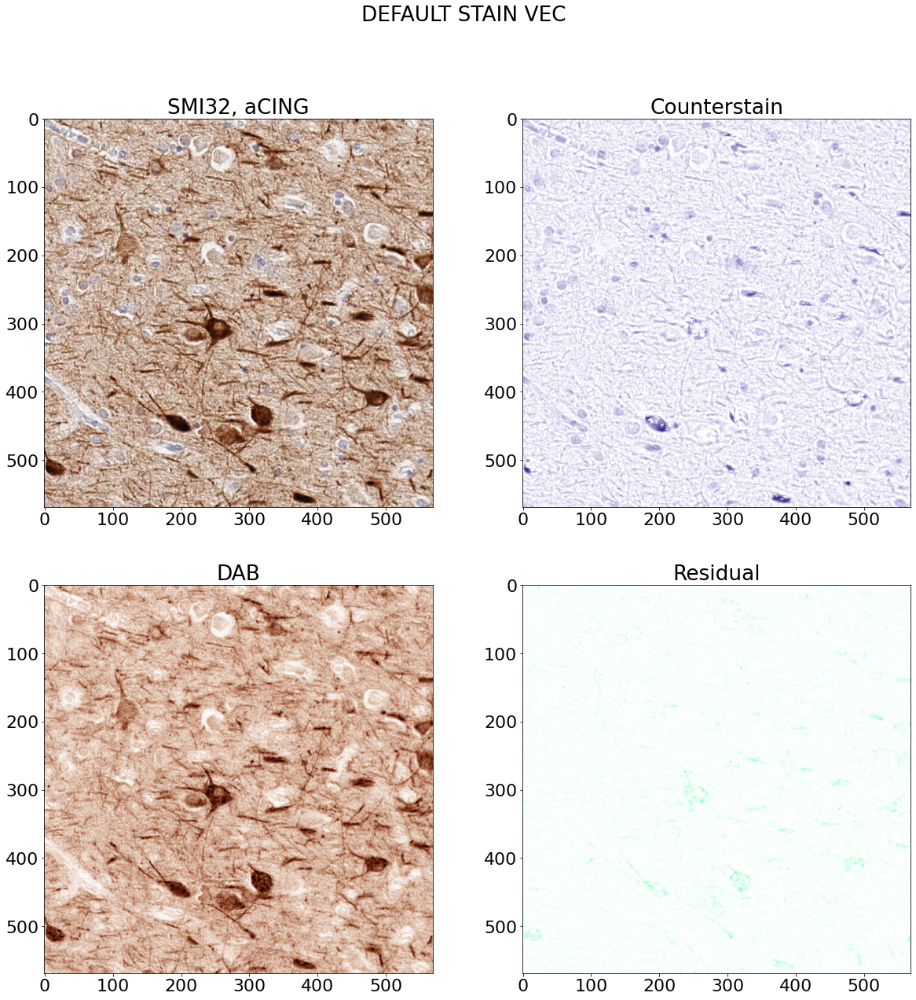

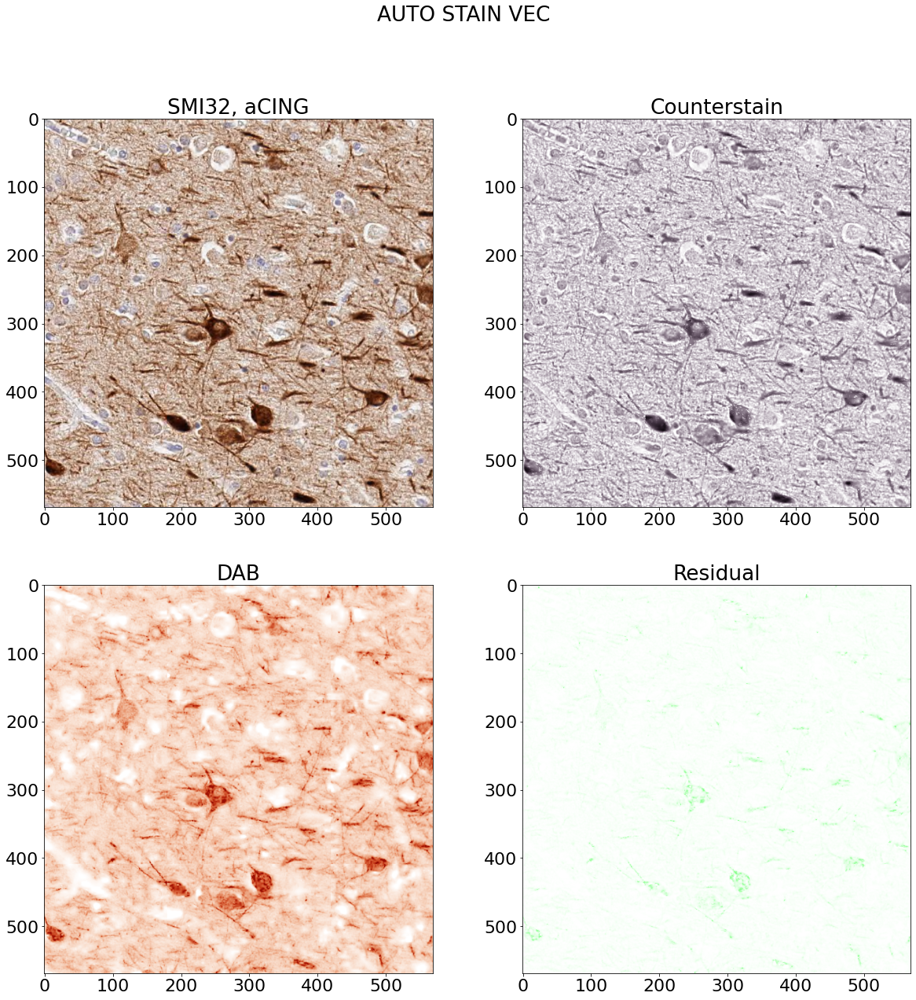

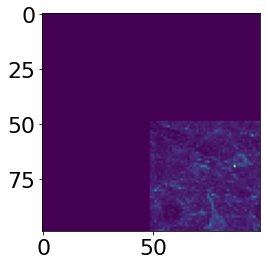

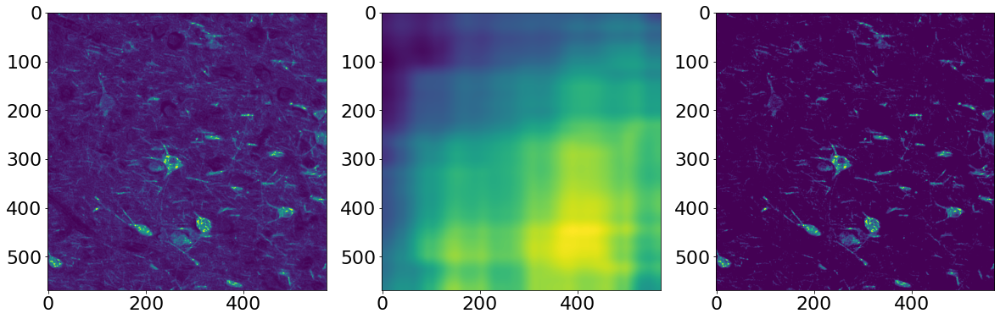

In [25]:
import sana_io
from sana_loader import Loader
from sana_params import Params
from sana_logger import SANALogger
from sana_color_deconvolution import StainSeparator
from matplotlib import pyplot as plt
import numpy as np
import matplotlib
matplotlib.rcParams.update({'font.size': 22})


adir = './annotations'
annotation_class = 'TEST_ROI'
frames, rois, loaders = [], [], []
for slide in slides:
    
    loader = Loader(slide)
    loader.set_lvl(0)
    
    params = Params()
    
    logger = SANALogger.get_sana_logger('normal')
    
    slide_name = os.path.splitext(os.path.basename(slide))[0]
    roi = sana_io.read_annotations(os.path.join(adir, slide_name+'.geojson'), class_name=annotation_class)[0]
        
    frame = loader.load_roi_frame(logger, params, roi)
        
    ss = StainSeparator('H-DAB')
    stains = ss.run(frame.img)
    
    z = np.zeros_like(stains[:,:,0])
    hem = ss.combine_stains(np.stack([stains[:,:,0], z, z]).transpose(1,2,0))
    dab = ss.combine_stains(np.stack([z, stains[:,:,1], z]).transpose(1,2,0))
    res = ss.combine_stains(np.stack([z, z, stains[:,:,2]]).transpose(1,2,0))
    
    auto_ss = StainSeparator('H-DAB')
    auto_ss.estimate_stain_vector(frame.img)
    auto_stains = auto_ss.run(frame.img)
    auto_hem = auto_ss.combine_stains(np.stack([auto_stains[:,:,0], z, z]).transpose(1,2,0))
    auto_dab = auto_ss.combine_stains(np.stack([z, auto_stains[:,:,1], z]).transpose(1,2,0))
    auto_res = auto_ss.combine_stains(np.stack([z, z, auto_stains[:,:,2]]).transpose(1,2,0))   
    
    antibody = sana_io.get_antibody(slide_name+'.svs')
    region = sana_io.get_region(slide_name+'.svs')
    title = '%s, %s' % (antibody, region)
    
    fig, axs = plt.subplots(2,2, figsize=(20,20))
    axs = axs.ravel()
    axs[0].imshow(frame.img)
    axs[0].set_title(title)
    axs[1].imshow(hem)
    axs[1].set_title('Counterstain')
    axs[2].imshow(dab)
    axs[2].set_title('DAB')
    axs[3].imshow(res)
    axs[3].set_title('Residual')
    try:
        os.makedirs('./plots')
    except:
        pass
    fig.suptitle('DEFAULT STAIN VEC')
    plt.savefig('./plots/%s_orig.png' % title)
    
    fig, axs = plt.subplots(2,2, figsize=(20,20))
    axs = axs.ravel()
    axs[0].imshow(frame.img)
    axs[0].set_title(title)
    axs[1].imshow(auto_hem)
    axs[1].set_title('Counterstain')
    axs[2].imshow(auto_dab)
    axs[2].set_title('DAB')
    axs[3].imshow(auto_res)
    axs[3].set_title('Residual')
    try:
        os.makedirs('./plots')
    except:
        pass
    fig.suptitle('AUTO STAIN VEC')
    plt.savefig('./plots/%s_auto.png' % title)
    
    ss = StainSeparator('H-DAB')
    stains = ss.run(frame.img)
    dab = frame_like(frame, stains[:,:,1])
    dab.rescale(ss.min_od[1], ss.max_od[1])
    proc = sana_frame.mean_normalize(dab, min_background=10, debug=True)
    
    frames.append(frame)
    rois.append(roi)
    loaders.append(loader)

0 232


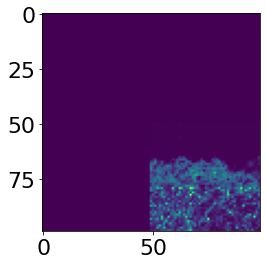

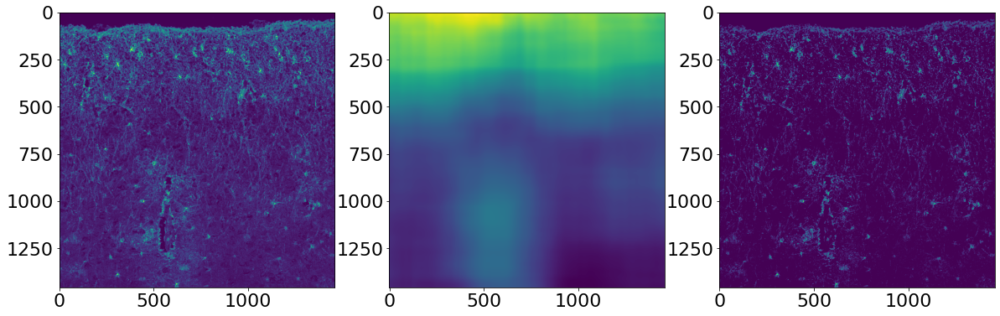

In [3]:
import importlib
import sana_frame
from sana_frame import frame_like, mean_normalize
import sana_tiler
importlib.reload(sana_frame)
importlib.reload(sana_tiler)
orig_frame = [frames[i] for i in range(len(frames)) if 'GFAP' in slides[i]][0]

ss = StainSeparator('H-DAB')
stains = ss.run(orig_frame.img)
frame = frame_like(orig_frame, stains[:,:,1])

# frame.img = (frame.img - np.mean(frame.img)) / np.std(frame.img)
frame.rescale(ss.min_od[1], ss.max_od[1])

lvl = 1
ds = int(frame.converter.ds[lvl] / frame.converter.ds[frame.lvl])

from scipy.ndimage import gaussian_filter


# radius = 300
# blur = gaussian_filter(frame.img, radius, radius=radius, mode='constant')
# blur = (blur - np.mean(blur)) / np.std(blur)
# print(np.max(blur), np.max(frame.img), np.min(frame.img))
# bckg = frame.img-blur

# fig, axs = plt.subplots(1,3, figsize=(20,20))
# axs[0].imshow(frame.img)
# axs[1].imshow(blur)
# axs[2].imshow(bckg)

proc = sana_frame.mean_normalize(frame, min_background=10, debug=True)

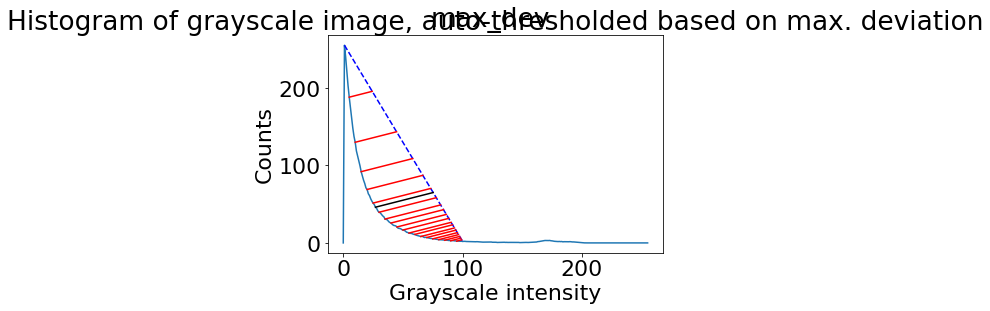

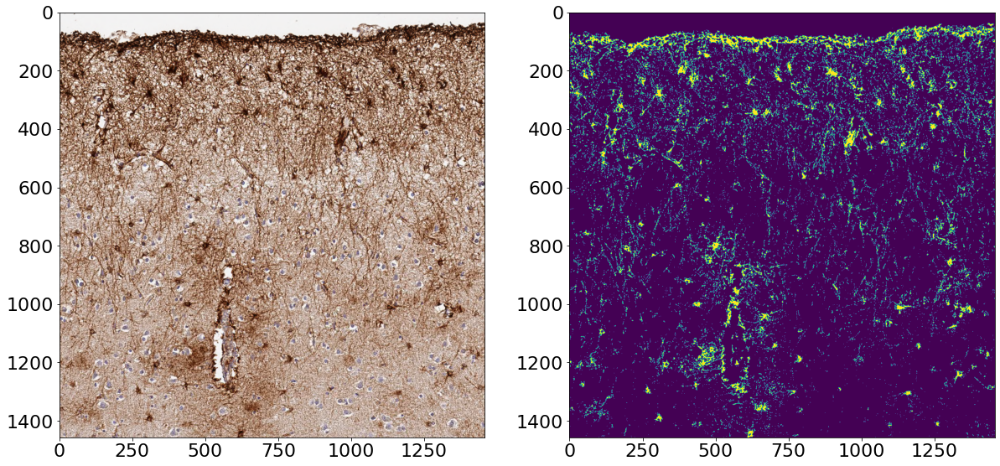

In [20]:
from sana_frame import overlay_thresh

from sana_thresholds import max_dev

hist = proc.histogram()
threshold = max_dev(hist, scale=1.0, mx=100, debug=True, show_debug=True)

thr = frame_like(orig_frame, proc.img > threshold)

overlay = overlay_thresh(orig_frame, thr)

fig, axs = plt.subplots(1,2, figsize=(20,20))
axs[0].imshow(orig_frame.img)
axs[1].imshow(thr.img)